# Image -> Video search

In [1]:
import os
import time
import io
import base64
from IPython.display import HTML

import sys
sys.path.insert(0, '../scripts')
import video_processing
import vector_search

videos_path = "../data/videos"
frames_path = "../data/frames"
features_mappings_path = '../data/features_mappings'
results_clips_path = "../data/results_clips"
new_image_path = "../data/photos/hills_river.jpg"

## Videos to Frames

Using OpenCV, extract 1 frame per second for every video.

In [2]:
video_processing.videos_to_frames(videos_path, frames_path)

Extracting frames from Cactaceas_especies_en_peligro_de_extincion_en_SLP.mp4
Finished extracting frames from Cactaceas_especies_en_peligro_de_extincion_en_SLP.mp4 .......... 19.58 seconds

Extracting frames from Swiftcurrent_Pass_and_Lookout_August_2012.mp4
Finished extracting frames from Swiftcurrent_Pass_and_Lookout_August_2012.mp4 .......... 13.96 seconds

Extracting frames from Greek_Layered_Dip_Recipe.mp4
Finished extracting frames from Greek_Layered_Dip_Recipe.mp4 .......... 14.4 seconds



## Generate Features, Map Them to Images, and Index Them for Fast Search

* Use Keras' MobileNet and its ImageNet pretrained weights to generate embeddings for the frames of the videos.
* Index the extracted features for fast search.

In [2]:
start_time = time.time()

index = {}
model = vector_search.load_headless_pretrained_model()

for video in os.listdir(frames_path):
    print('Video .... {}.mp4'.format(video))
    
    if not os.path.exists(os.path.join(features_mappings_path, video)):
        os.mkdir(os.path.join(features_mappings_path, video))
        image_paths = [os.path.join(frames_path, video, "frame{}.png".format(i))
                       for i in range(len(os.listdir(os.path.join(frames_path, video))))]
        
        images_features, file_index = vector_search.generate_features(image_paths, model)
        vector_search.save_features(os.path.join(features_mappings_path, video, 'features'), images_features, 
                                    os.path.join(features_mappings_path, video, 'mapping_filename'), file_index)
        image_index = vector_search.index_features(images_features)
        index[video] = (image_index, file_index)
        print('Finished ... {} seconds\n'.format(time.time() - start_time))
    else:
        print("The features have already been extracted ...")
        images_features, file_index = vector_search.load_features(os.path.join(features_mappings_path, video, 'features'), 
                                                                  os.path.join(features_mappings_path, video, 'mapping_filename'))
        image_index = vector_search.index_features(images_features)
        index[video] = (image_index, file_index)
        print('Finished ... {} seconds\n'.format(time.time() - start_time))

Video .... Swiftcurrent_Pass_and_Lookout_August_2012.mp4
Generating features...
Saving features...
Indexing features...
Finished ... 145.41183185577393 seconds

Video .... Cactaceas_especies_en_peligro_de_extincion_en_SLP.mp4
Generating features...
Saving features...
Indexing features...
Finished ... 271.52915501594543 seconds

Video .... Greek_Layered_Dip_Recipe.mp4
Generating features...
Saving features...
Indexing features...
Finished ... 375.9775469303131 seconds



## Search through frames using the embeddings

### Input is a frame

* Search for frames that are similar to the given **input frame**. 
* Reconstruct parts of the videos containing the resulting frames.

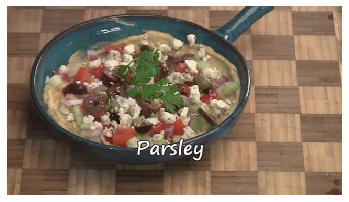

In [3]:
search_key = 190   # this corresponds to the number of the frame shown below
video = "Greek_Layered_Dip_Recipe"
video_processing.plot_image(os.path.join(frames_path, video, "frame{}.png".format(search_key)))

In [4]:
start_time = time.time()
search_vector = index[video][0].get_item_vector(search_key)
feature_index = index[video][0]
item_mapping = index[video][1]

results = {}
for video in index.keys():
    results[video] = vector_search.search_index_by_value(vector=search_vector, 
                                                         feature_index=index[video][0], 
                                                         item_mapping=index[video][1], 
                                                         top_n=12)
print("Done searching! ... {} seconds".format(time.time() - start_time))

Done searching! ... 0.008638858795166016 seconds


In [5]:
# Look at the results
for video_name in results.keys():
    print(video_name)
    for i, h in enumerate(results[video_name]):
        print(i, "...", h)

Swiftcurrent_Pass_and_Lookout_August_2012
0 ... [13, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame13.png', 1.2802530527114868]
1 ... [25, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame25.png', 1.2815265655517578]
2 ... [36, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame36.png', 1.310086727142334]
3 ... [22, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame22.png', 1.3233376741409302]
4 ... [12, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame12.png', 1.3304959535598755]
5 ... [31, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame31.png', 1.3314608335494995]
6 ... [260, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame260.png', 1.3318021297454834]
7 ... [272, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame272.png', 1.3352547883987

## Plot similar frames found by the search¶

In [7]:
for key in results.keys():
    print(key)

Swiftcurrent_Pass_and_Lookout_August_2012
Cactaceas_especies_en_peligro_de_extincion_en_SLP
Greek_Layered_Dip_Recipe


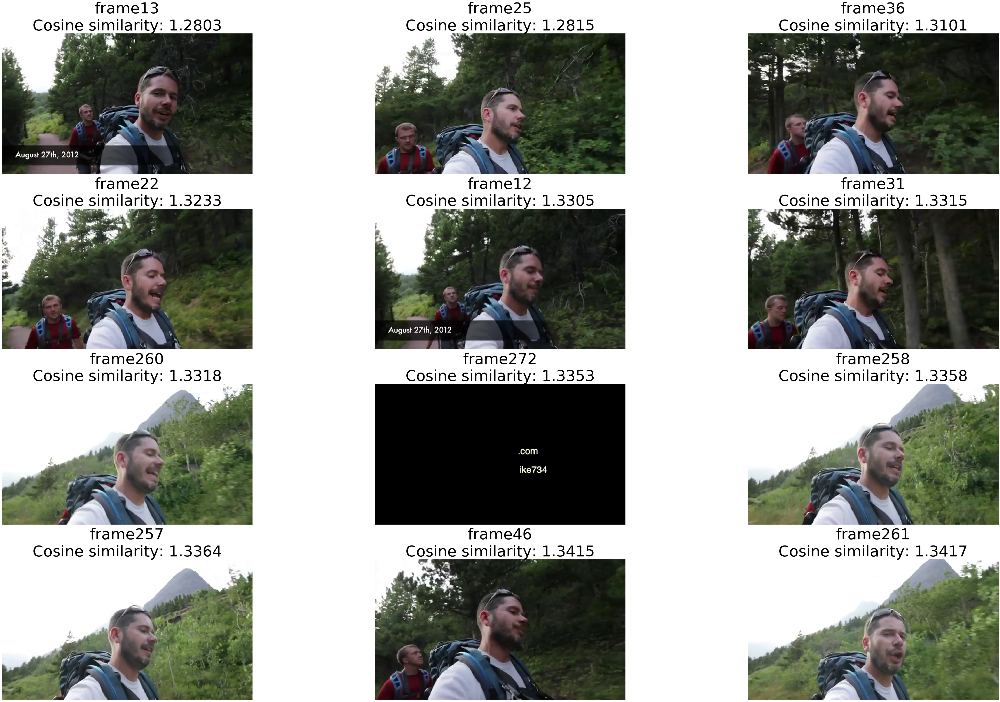

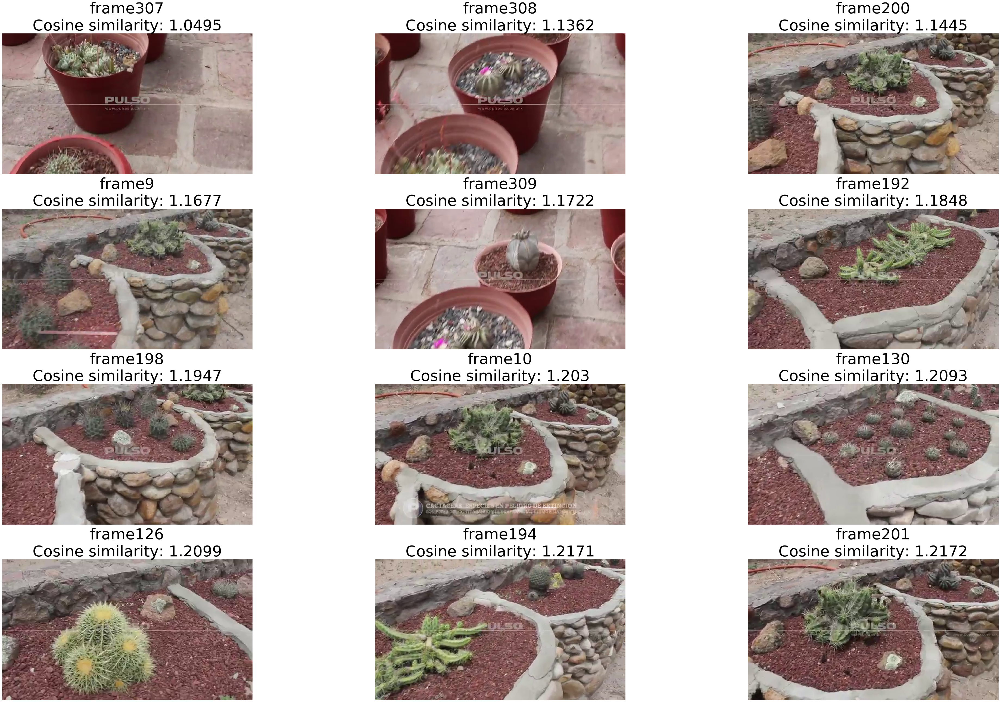

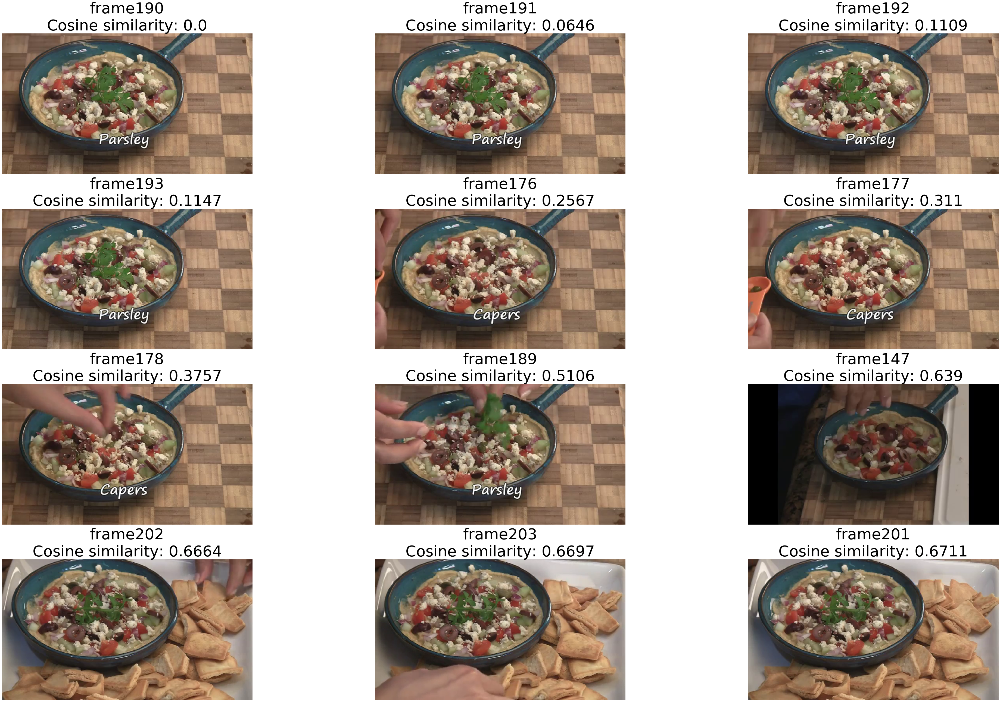

In [7]:
for video in results.keys():
    video_processing.plot_similar_frames(frames_path, video, results, n_frames=12)

## Assemble Frames into Video Clips

First, let's order the indices of the results. 
* Indices correspond to the time (in seconds) of the frame 
* Remember that we extracted 1 frame for each second

In [8]:
indices_ordered = video_processing.order_frame_indices(results)
for video_name in indices_ordered:
    print(video_name, "...", indices_ordered[video_name])

Swiftcurrent_Pass_and_Lookout_August_2012 ... []
Cactaceas_especies_en_peligro_de_extincion_en_SLP ... []
Greek_Layered_Dip_Recipe ... [[147], [176, 177, 178], [189, 190, 191, 192, 193], [201, 202, 203]]


In [11]:
start_time = time.time()
video_processing.frames_to_videos(videos_path, indices_ordered, results_clips_path)
print("\nDone constructing video clips ... {} seconds".format(time.time() - start_time))


[MoviePy] Running:
>>> /Users/araks/anaconda3/envs/tensorflow_env/bin/ffmpeg -y -i ../../data/testing_train/videos/Greek_Layered_Dip_Recipe.mp4 -ss 175.00 -t 4.00 -vcodec copy -acodec copy ../../data/testing_train/results_clips/Greek_Layered_Dip_Recipe/subvideo_0.mp4
... command successful.

[MoviePy] Running:
>>> /Users/araks/anaconda3/envs/tensorflow_env/bin/ffmpeg -y -i ../../data/testing_train/videos/Greek_Layered_Dip_Recipe.mp4 -ss 188.00 -t 6.00 -vcodec copy -acodec copy ../../data/testing_train/results_clips/Greek_Layered_Dip_Recipe/subvideo_1.mp4
... command successful.

[MoviePy] Running:
>>> /Users/araks/anaconda3/envs/tensorflow_env/bin/ffmpeg -y -i ../../data/testing_train/videos/Greek_Layered_Dip_Recipe.mp4 -ss 200.00 -t 4.00 -vcodec copy -acodec copy ../../data/testing_train/results_clips/Greek_Layered_Dip_Recipe/subvideo_2.mp4
... command successful.

Done constructing video clips ... 0.6029989719390869 seconds


In [13]:
video = io.open(os.path.join(results_clips_path, 'Greek_Layered_Dip_Recipe/subvideo_0.mp4'), 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

## Search through frames using the embeddings

### Input is not a frame

* Search for frames that are similar to the given **image (not a frame)**. 
    * Credit for the image: [David Marcu](https://unsplash.com/photos/3PYhg4qM78I)
* Reconstruct parts of the videos containing the resulting frames.

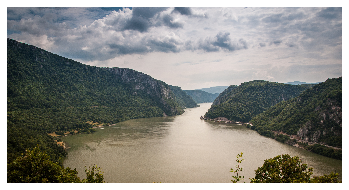

In [14]:
video_processing.plot_image(new_image_path)

In [12]:
start_time = time.time()

model = vector_search.load_headless_pretrained_model()
image_features = vector_search.generate_features_single_photo(new_image_path, model)

print("Done generating features from image ... {} seconds".format(time.time() - start_time))

Done generating features from image ... 14.146084070205688 seconds


In [13]:
start_time = time.time()

results = {}
for video in index.keys():
    results[video] = vector_search.search_index_by_value(image_features, index[video][0], index[video][1], top_n=15)
    
print('Done searching ... {} seconds'.format(time.time() - start_time))

Done searching ... 0.005769968032836914 seconds


In [14]:
# assemble into video clips
for video_name in results.keys():
    print(video_name)
    for i, h in enumerate(results[video_name]):
        print(i, "...", h)

Swiftcurrent_Pass_and_Lookout_August_2012
0 ... [209, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame209.png', 0.689103364944458]
1 ... [159, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame159.png', 0.7013092041015625]
2 ... [208, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame208.png', 0.7026728987693787]
3 ... [207, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame207.png', 0.7041303515434265]
4 ... [158, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame158.png', 0.7059829235076904]
5 ... [206, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame206.png', 0.7085068821907043]
6 ... [165, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame165.png', 0.723152756690979]
7 ... [129, '../../data/testing_train/frames/Swiftcurrent_Pass_and_Lookout_August_2012/frame129.png', 0.74

In [15]:
# plot similar frames
for key in results.keys():
    print(key)

Swiftcurrent_Pass_and_Lookout_August_2012
Cactaceas_especies_en_peligro_de_extincion_en_SLP
Greek_Layered_Dip_Recipe


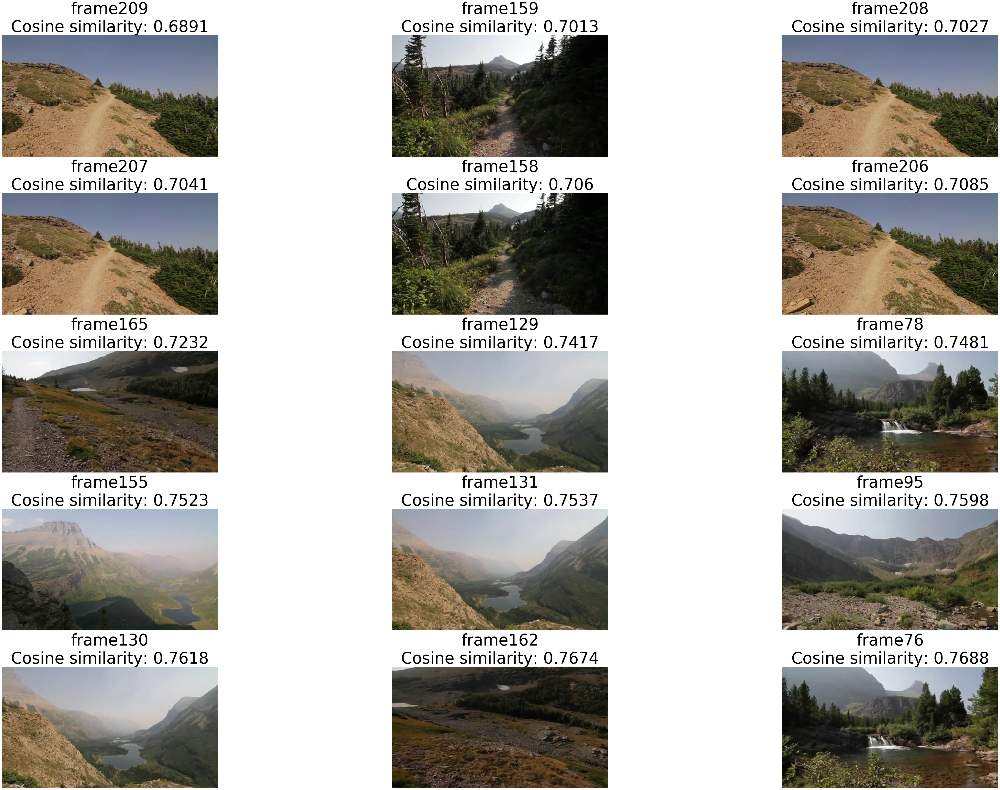

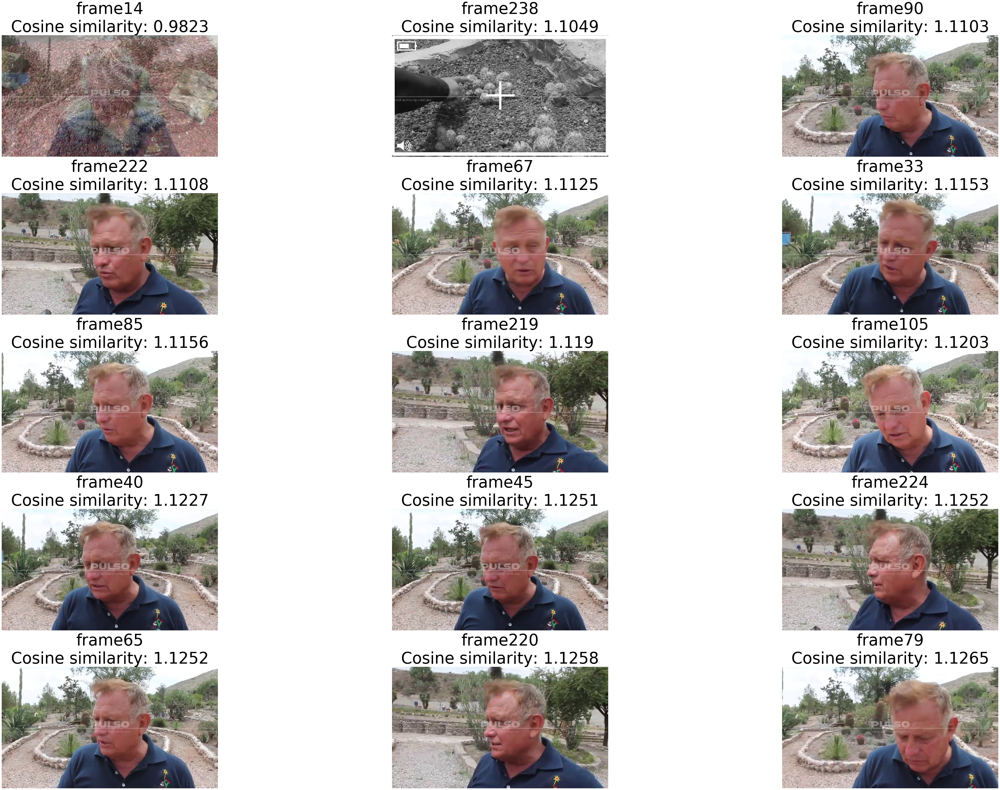

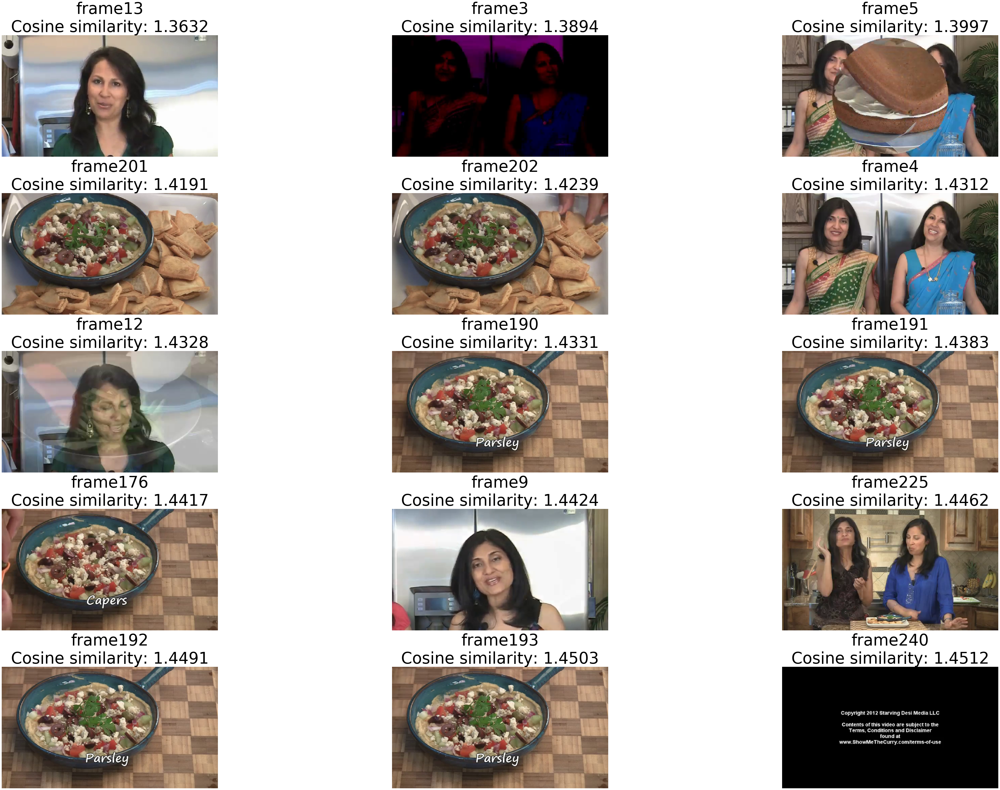

In [20]:
for video in results.keys():
    video_processing.plot_similar_frames(frames_path, video, results, n_frames=15)

In [16]:
indices_ordered = video_processing.order_frame_indices(results, cosine_threshold=0.8)
for video_name in indices_ordered:
    print(video_name, "...", indices_ordered[video_name])

Swiftcurrent_Pass_and_Lookout_August_2012 ... [[76], [78], [95], [129, 130, 131], [155], [158, 159], [162], [165], [206, 207, 208, 209]]
Cactaceas_especies_en_peligro_de_extincion_en_SLP ... []
Greek_Layered_Dip_Recipe ... []


In [17]:
start_time = time.time()

video_processing.frames_to_videos(videos_path, indices_ordered, results_clips_path)

print('Done constructing video clips ... {} seconds'.format(time.time() - start_time))


[MoviePy] Running:
>>> /Users/araks/anaconda3/envs/tensorflow_env/bin/ffmpeg -y -i ../../data/testing_train/videos/Swiftcurrent_Pass_and_Lookout_August_2012.mp4 -ss 128.00 -t 4.00 -vcodec copy -acodec copy ../../data/testing_train/results_clips/Swiftcurrent_Pass_and_Lookout_August_2012/subvideo_0.mp4
... command successful.

[MoviePy] Running:
>>> /Users/araks/anaconda3/envs/tensorflow_env/bin/ffmpeg -y -i ../../data/testing_train/videos/Swiftcurrent_Pass_and_Lookout_August_2012.mp4 -ss 205.00 -t 5.00 -vcodec copy -acodec copy ../../data/testing_train/results_clips/Swiftcurrent_Pass_and_Lookout_August_2012/subvideo_1.mp4
... command successful.
Done constructing video clips ... 0.41377687454223633 seconds


In [18]:
video = io.open(os.path.join(results_clips_path, 'Swiftcurrent_Pass_and_Lookout_August_2012/subvideo_0.mp4'), 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

## References

1. Semantic Search,  https://github.com/hundredblocks/semantic-search